In [168]:
import pandas as pd
import os
import matplotlib.pyplot as plt
from scipy import signal

from visual_behavior import database as db
import visual_behavior.utilities as vbu
import visual_behavior.plotting as vbppi
import visual_behavior.database as db

from visual_behavior.translator.foraging2 import data_to_change_detection_core

from multiprocessing import Pool

from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.express as px

from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [2]:
%matplotlib notebook

In [66]:
def event_triggered_response(df, parameter, event_times, t_before=10, t_after=10, sampling_rate=60):
    '''
    build event triggered response around a given set of events
    required inputs:
      df: dataframe of input data
      parameter: column of input dataframe to extract around events
      event_times: times of events of interest
    optional inputs:
      t_before: time before each of event of interest
      t_after: time after each event of interest
      sampling_rate: desired sampling rate of output (input data will be interpolated)
    output:
      dataframe with one time column ('t') and one column of data for each event
    '''
    if 't' in df.columns:
        time_key = 't'
    else:
        time_key = 'time'
        
    d = {time_key:np.arange(-t_before,t_after, 1/sampling_rate)}
    for ii,event_time in enumerate(np.array(event_times)):

        df_local = df.query("{0} > (@event_time - @t_before) and {0} < (@event_time + @t_after)".format(time_key))
        t = df_local[time_key] - event_time
        y = df_local[parameter]
        
        d.update({'event_time={}'.format(event_time):np.interp(d[time_key], t, y)})
    return pd.DataFrame(d)

In [67]:
def convert_to_fraction(df_in):
    df = df_in.copy()
    cols = [col for col in df.columns if col not in ['t','time']]
    for col in cols:
        s = df[col]
        s0 = df[col].mean(axis=0)
        df[col] = (s - s0)/s0
    return df

def designate_flashes(ax,omit=None,pre_color='blue',post_color='blue'):
    '''add vertical spans to designate stimulus flashes'''
    lims = ax.get_xlim()
    for flash_start in np.arange(0,lims[1],0.75):
        if flash_start != omit:
            ax.axvspan(flash_start,flash_start+0.25,color=post_color,alpha=0.25,zorder=-np.inf)
    for flash_start in np.arange(-0.75,lims[0]-0.001,-0.75):
        if flash_start != omit:
            ax.axvspan(flash_start,flash_start+0.25,color=pre_color,alpha=0.25,zorder=-np.inf)

In [3]:
def get_session_ids(folder='/ssd1'):
    session_ids = np.array([903866897,907991407,907279865,906501403,])
    return np.unique(session_ids)

In [4]:
def get_raw_points_path(session_id,folder='/ssd1'):
    return glob.glob(os.path.join(folder,'{}*1030000.h5'.format(session_id)))[0]

def get_raw_points(session_id,folder='/ssd1'):
    path = get_raw_points_path(session_id,folder=folder)
    raw_points = pd.read_hdf(path)
    return raw_points

In [5]:
def get_storage_directory(session_id):
    return glob.glob('/sd5/sd5.3/{}*'.format(session_id))[0]

In [6]:
def get_ellipse_path(session_id,folder='/ssd1'):
    path = glob.glob(os.path.join(folder,'{}*1030000_ellipse.h5'.format(session_id)))[0]
    return path

In [7]:
def get_sync_path(session_id):
    storage_dir = get_storage_directory(session_id)
    return glob.glob(os.path.join(storage_dir,'*.sync'.format(session_id)))[0]

def get_movie_path(session_id,movie_type):
    '''
    movie_type can be 'eye' or 'behavior'
    '''
    storage_dir = get_storage_directory(session_id)
    return glob.glob(os.path.join(storage_dir,'*{}.avi'.format(movie_type)))[0]

In [51]:
def load_behavior_data(session_id):

    storage_dir = get_storage_directory(session_id)

    rf_mapping_path = glob.glob(os.path.join(get_storage_directory(session_id),'*[0-9].pkl'))[0]
    replay_prototype = pd.read_pickle('/ssd1/passive_replay_prototype_190404172058.pkl')

    rf_mapping_pkl = pd.read_pickle(rf_mapping_path)

    sd = vbu.get_sync_data(get_sync_path(session_id))

    core_data = data_to_change_detection_core(replay_prototype,time=sd['stim_vsync_falling'][len(rf_mapping_pkl['intervalsms']):])

    assert len(core_data['time']) + len(rf_mapping_pkl['intervalsms']) == len(sd['stim_vsync_falling'])
    
    return core_data

# load data

In [52]:
session_ids = get_session_ids()

bd = {}
ed = {}
for session_id in session_ids:
    filepaths = {
        'ellipse_fits': get_ellipse_path(session_id),
        'raw_tracking_points': get_raw_points_path(session_id),
        'sync':get_sync_path(session_id),
        'eye_movie':get_movie_path(session_id,'eye'),
        'behavior_movie':get_movie_path(session_id,'behavior'),
    }
    ed[session_id] = vbu.EyeTrackingData(session_id, filepaths=filepaths)
    bd[session_id] = load_behavior_data(session_id)

<IPython.core.display.Javascript object>


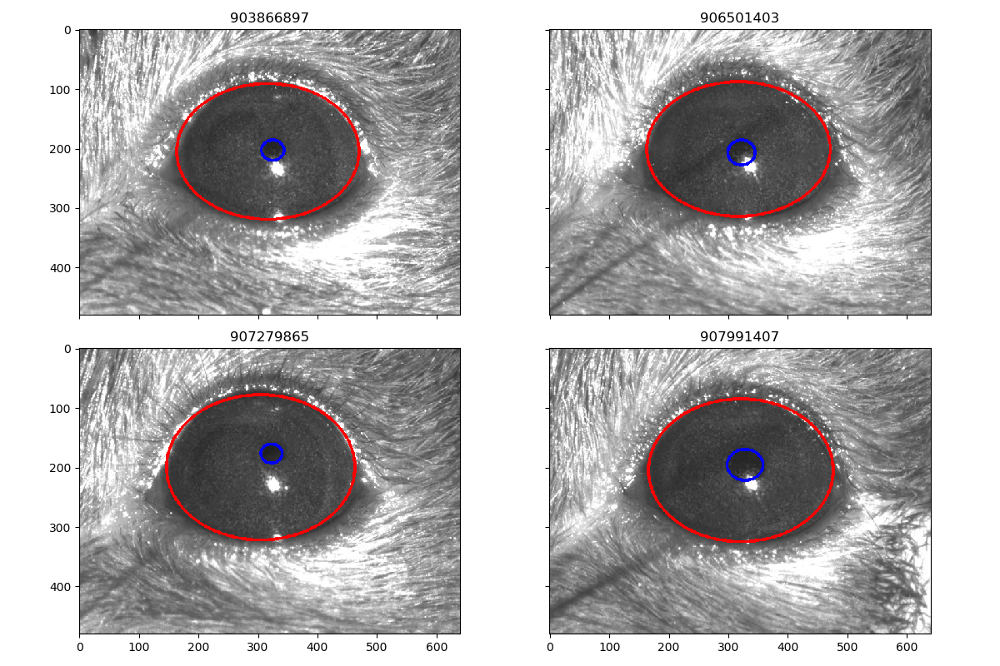

In [64]:
fig,ax=plt.subplots(2,2,figsize=(12,8),sharex=True,sharey=True)
for ii,session_id in enumerate(session_ids):
    ax.flatten()[ii].imshow(ed[session_id].get_annotated_frame(10000))
    ax.flatten()[ii].set_title(session_id)
fig.tight_layout()

In [71]:
omitted_flash_table = bd[session_id]['omitted_stimuli']
omitted_flash_table['time'].values

array([1735.49273, 1765.51771, 1803.08233, 1815.09232, 1824.09978,
       1841.3641 , 1857.87788, 1866.13465, 1896.17685, 1911.18884,
       1937.46056, 1939.71189, 1944.21613, 1973.47373, 1978.72809,
       1987.76873, 2033.57444, 2035.0915 , 2040.34596, 2077.89376,
       2083.14813, 2120.69597, 2122.19719, 2150.00363, 2158.26049,
       2187.53482, 2192.78915, 2202.56436, 2267.90138, 2363.23049,
       2396.25812, 2424.03111, 2439.04371, 2474.32298, 2487.08355,
       2490.08596, 2526.13259, 2529.13515, 2583.94704, 2588.45089,
       2601.97877, 2607.98389, 2624.49769, 2640.27743, 2644.03041,
       2661.31142, 2673.32152, 2696.52445, 2730.31887, 2733.32132,
       2770.86922, 2773.8717 , 2803.91403, 2813.68815, 2821.94647,
       2841.46107, 2873.02078, 2894.03802, 2901.56114, 2917.32416,
       2930.83539, 2961.62763, 2993.90443, 3028.43311, 3040.44308,
       3057.70744, 3068.21595, 3069.71741, 3080.20926, 3109.50096,
       3128.26582, 3133.53707, 3148.54951, 3180.82634, 3197.34

<IPython.core.display.Javascript object>


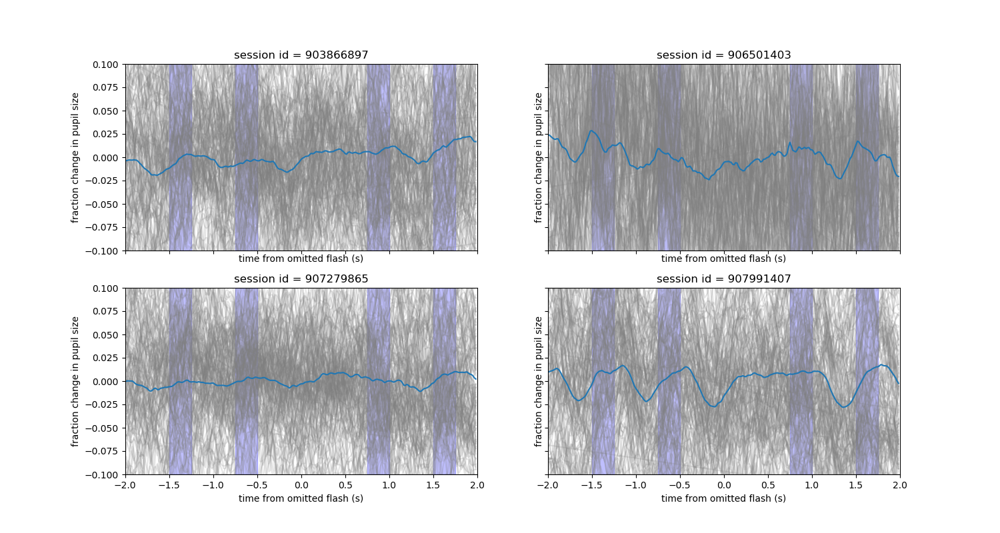

In [165]:
etr_fractional_change = {}

fig,axes=plt.subplots(2,2,figsize=(15,8),sharex=True,sharey=True)

for ii,session_id in enumerate(session_ids):
    
    ax = axes.flatten()[ii]
    omitted_flash_table = bd[session_id]['omitted_stimuli']
    etr = event_triggered_response(ed[session_id].ellipse_fits['pupil'], 'normalized_blink_corrected_area', omitted_flash_table['time'].values, t_before=2, t_after=2,)
    etr_fractional_change[session_id] = convert_to_fraction(etr)
    df = etr_fractional_change[session_id]                 
    
    cols = [c for c in df.columns if c != 'time']
    for col in cols:
        ax.plot(df['time'],df[col],color='gray',alpha=0.2)
    ax.plot(df['time'],df[cols].mean(axis=1))
    
    designate_flashes(ax,omit=0)
    ax.set_xlim(-2,2)
    ax.set_title('session id = {}'.format(session_id))
    ax.set_xlabel('time from omitted flash (s)')
    ax.set_ylabel('fraction change in pupil size')
    ax.set_ylim(-0.1,0.1)

## plotly version of above plot

In [216]:
def designate_flashes_plotly(fig,omit=None,pre_color='blue',post_color='blue',alpha=0.25,rows=[1],cols=[1],lims=[-10,10]):
    '''add vertical spans to designate stimulus flashes'''

    shape_list = []
    for row in np.unique(np.array(rows)):
        for col in np.unique(np.array(cols)):
            for flash_start in np.arange(0,lims[1],0.75):
                if flash_start != omit:
                    shape_list.append(
                        go.layout.Shape(
                            type="rect",
                            x0=flash_start,
                            y0=-2,
                            x1=flash_start+0.25,
                            y1=2,
                            fillcolor=post_color,
                            opacity=alpha,
                            layer="below",
                            line_width=0,
                            xref='x{}'.format(col),
                            yref='y{}'.format(row),
                        ),
                    )
            for flash_start in np.arange(-0.75,lims[0]-0.001,-0.75):
                if flash_start != omit:
                    shape_list.append(
                        go.layout.Shape(
                            type="rect",
                            x0=flash_start,
                            y0=-2,
                            x1=flash_start+0.25,
                            y1=2,
                            fillcolor=pre_color,
                            opacity=alpha,
                            layer="below",
                            line_width=0,
                            xref='x{}'.format(col),
                            yref='y{}'.format(row),
                        ),
                    )

    fig.update_layout(shapes=shape_list)

In [221]:
etr_fractional_change = {}

fig = make_subplots(rows=1, cols=4, shared_xaxes=True, shared_yaxes=True,subplot_titles=['Session ID = {}'.format(str(sid)) for sid in session_ids])

rows = [1,1,1,1]
columns = [1,2,3,4]
for ii,session_id in enumerate(session_ids):
    
    row,column = rows[ii],columns[ii]

    omitted_flash_table = bd[session_id]['omitted_stimuli']
    etr = event_triggered_response(ed[session_id].ellipse_fits['pupil'], 'normalized_blink_corrected_area', omitted_flash_table['time'].values, t_before=3, t_after=3,)
    etr_fractional_change[session_id] = convert_to_fraction(etr)
    df = etr_fractional_change[session_id]                 
    
    cols = [c for c in df.columns if c != 'time']
    for col in cols:
        fig.add_trace(
            go.Scatter(
                x = df['time'],
                y = df[col],
                opacity=0.10,
                showlegend=False,
                name=col,
            ),
            row=row, 
            col=column,
        )
    fig.add_trace(
        go.Scatter(
            x = df['time'],
            y = df[cols].mean(axis=1),
            opacity=1,
            line = {'width':4,'color':'black'},
            showlegend=True,
            name='session_id={}'.format(session_id),
        ),
        row=row, 
        col=column,
    )
    fig.update_xaxes(title_text="time from omitted flash (s)", row=row, col=column)
    if column == 1:
        fig.update_yaxes(title_text="fraction change in pupil area", row=row, col=column)

fig.update_layout(
    title="Pupil response in untrained mice (collected on NP1 by Josh Siegle)",
    showlegend=False
)
fig.update_yaxes(range=[-0.1,0.1])
designate_flashes_plotly(fig,omit=0,pre_color='blue',post_color='blue',cols=columns, rows=rows ,lims=[-3,3], alpha=0.75)

fig.write_html("/home/dougo/code/dougollerenshaw.github.io/figures_to_share/untrained_mice_omitted_flash_resonse_2020.01.03.html")
fig.show()